In [ ]:
!pip install colpali_engine==0.1.1

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.6/251.6 kB 7.5 MB/s eta 0:00:00
  Created wheel for gputil: filename=GPUtil-1.4.0-py3-none-any.whl size=7392 sha256=3f97a3ef539454ebfd10e2d5f73dce4f6fa3bb426777e970bd1a3d03a08749ae
  Stored in directory: /root/.cache/pip/wheels/a9/8a/bd/81082387151853ab8b6b3ef33426e98f5cbfebc3c397a9d4d0
Successfully built gputil


In [ ]:
!pip install "colpali-engine[train]"

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 471.6/471.6 kB 16.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 45.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 122.4/122.4 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.9/39.9 MB 18.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 287.4/287.4 kB 23.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 245.3/245.3 kB 23.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 13.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 18.0 MB/s eta 0:00:00
  Attempting uninstall: pyarrow
    Found existing installation: pyarrow 14.0.2
    Uninstalling pyarrow-14.0.2:
      Successfully uninstalled pyarrow-14.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behavio

In [ ]:
!pip install pdf2image

In [ ]:
import torch
import typer
from torch.utils.data import DataLoader
from tqdm import tqdm
from transformers import AutoProcessor
from PIL import Image
from typing import List, Tuple, Union

In [ ]:
from colpali_engine.models.paligemma_colbert_architecture import ColPali
from colpali_engine.trainer.retrieval_evaluator import CustomEvaluator
from colpali_engine.utils.colpali_processing_utils import process_images, process_queries
from colpali_engine.utils.image_from_page_utils import load_from_dataset

In [ ]:
from colpali_engine.trainer.retrieval_evaluator import CustomEvaluator

In [ ]:
from pdf2image import convert_from_path

In [ ]:
!sudo apt-get install poppler-utils

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  poppler-utils
0 upgraded, 1 newly installed, 0 to remove and 49 not upgraded.
Need to get 186 kB of archives.
After this operation, 696 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 poppler-utils amd64 22.02.0-2ubuntu0.5 [186 kB]
Fetched 186 kB in 1s (213 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package poppler-utils.
(Reading database ... 123614 

In [ ]:
!pip install faiss-cpu

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 27.0/27.0 MB 79.9 MB/s eta 0:00:00


In [ ]:
from IPython.display import display

In [ ]:
import torch
from transformers import AutoProcessor
from PIL import Image
from typing import List, Tuple, Union, Dict, Optional
import faiss
import numpy as np
from colpali_engine.models.paligemma_colbert_architecture import ColPali
from pdf2image import convert_from_path
from IPython.display import display
import os
import re
from tqdm import tqdm

def load_colpali_model(model_name: str = "vidore/colpaligemma-3b-mix-448-base") -> Tuple[ColPali, AutoProcessor]:
    model = ColPali.from_pretrained(model_name, torch_dtype=torch.bfloat16, device_map="cuda").eval()
    processor = AutoProcessor.from_pretrained(model_name)
    return model, processor

def pdf_to_images(pdf_path: str) -> List[Tuple[Image.Image, Dict[str, Union[str, int]]]]:
    try:
        images = convert_from_path(pdf_path)
        return [(img, {"page": i + 1, "filename": os.path.basename(pdf_path)}) for i, img in enumerate(images)]
    except Exception as e:
        print(f"Error converting PDF {pdf_path}: {e}")
        return []

def process_images(images_with_metadata: List[Tuple[Image.Image, Dict[str, Union[str, int]]]], processor: AutoProcessor, model: ColPali) -> Tuple[np.ndarray, List[Dict[str, Union[str, int]]]]:
    image_embeddings = []
    metadata_list = []

    for image, metadata in tqdm(images_with_metadata, desc="Processing images"):
        inputs = processor(images=image, return_tensors="pt")
        inputs = {k: v.to(model.device) for k, v in inputs.items()}

        with torch.no_grad():
            embeddings = model(**inputs)

        mean_embedding = torch.mean(embeddings, dim=1).float().cpu().numpy()
        image_embeddings.append(mean_embedding)
        metadata_list.append(metadata)

    return np.vstack(image_embeddings), metadata_list

def create_faiss_index(embeddings: np.ndarray) -> faiss.Index:
    dimension = embeddings.shape[1]
    index = faiss.IndexFlatL2(dimension)
    index.add(embeddings)
    return index

def process_query(query: str, processor: AutoProcessor, model: ColPali) -> np.ndarray:
    mock_image = Image.new('RGB', (224, 224), color='white')

    inputs = processor(text=query, images=mock_image, return_tensors="pt")
    inputs = {k: v.to(model.device) for k, v in inputs.items()}

    with torch.no_grad():
        embeddings = model(**inputs)

    return torch.mean(embeddings, dim=1).float().cpu().numpy()

def preprocess_query(query: str) -> str:
    query = query.lower()
    query = re.sub(r'[^\w\s]', '', query)
    return query.strip()

def enrich_metadata(metadata_list: List[Dict[str, Union[str, int]]], images: List[Image.Image]) -> List[Dict[str, Union[str, int]]]:
    enriched_metadata = []
    for metadata, image in zip(metadata_list, images):
        # Add image-specific metadata if needed
        metadata['image_size'] = image.size
        enriched_metadata.append(metadata)
    return enriched_metadata

def search_images(
    query: str,
    model: ColPali,
    processor: AutoProcessor,
    faiss_index: faiss.Index,
    images: List[Image.Image],
    metadata_list: List[Dict[str, Union[str, int]]],
    top_k: int = 5
) -> List[Tuple[int, float, Optional[Image.Image], Dict[str, Union[str, int]]]]:
    query = preprocess_query(query)
    query_embedding = process_query(query, processor, model)
    distances, indices = faiss_index.search(query_embedding, top_k)

    results = []
    for idx, distance in zip(indices[0], distances[0]):
        image = images[idx] if idx < len(images) else None
        metadata = metadata_list[idx] if idx < len(metadata_list) else {}
        results.append((idx, distance, image, metadata))

    return results

def display_results(results: List[Tuple[int, float, Optional[Image.Image], Dict[str, Union[str, int]]]], query: str):
    print(f"Query: {query}")
    print(f"Top {len(results)} results:")
    for rank, (idx, distance, image, metadata) in enumerate(results, 1):
        print(f"Rank {rank}:")
        print(f"  Page: {metadata.get('page', 'N/A')}")
        print(f"  File: {metadata.get('filename', 'N/A')}")
        print(f"  Distance: {distance:.4f}")
        if 'image_size' in metadata:
            print(f"  Image Size: {metadata['image_size']}")
        if image:
            display(image)
        else:
            print("  (Image not available)")
        print()

In [ ]:
def calculate_mrr(
    queries_with_correct_pages: List[Tuple[str, int]],
    model: ColPali,
    processor: AutoProcessor,
    faiss_index: faiss.Index,
    metadata_list: List[Dict[str, Union[str, int]]],
    top_k: int = 10
) -> float:
    reciprocal_ranks = []
    for query, correct_page in queries_with_correct_pages:
        results = search_images(query, model, processor, faiss_index, [], metadata_list, top_k)
        for rank, (_, _, _, metadata) in enumerate(results, 1):
            if metadata.get('page') == correct_page:
                reciprocal_ranks.append(1 / rank)
                break
        else:
            reciprocal_ranks.append(0)

    mrr = sum(reciprocal_ranks) / len(reciprocal_ranks)
    return mrr

def evaluate_and_display_results(
    queries_with_correct_pages: List[Tuple[str, int]],
    model: ColPali,
    processor: AutoProcessor,
    faiss_index: faiss.Index,
    images: List[Image.Image],
    metadata_list: List[Dict[str, Union[str, int]]],
    top_k: int = 5
):
    mrr = calculate_mrr(queries_with_correct_pages, model, processor, faiss_index, metadata_list, top_k)
    print(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    print("\nDetailed Results:")

    for query, correct_page in queries_with_correct_pages:
        results = search_images(query, model, processor, faiss_index, images, metadata_list, top_k)
        print(f"\nQuery: {query}")
        print(f"Correct Page: {correct_page}")
        display_results(results, query)

In [ ]:
pdf_path = "/content/groww-client-guidance.pdf"

In [ ]:
model, processor = load_colpali_model()

config.json:   0%|          | 0.00/1.02k [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/paligemma/configuration_paligemma.py:137: FutureWarning: The `vocab_size` attribute is deprecated and will be removed in v4.44, Please use `text_config.vocab_size` instead.
  warnings.warn(


model.safetensors.index.json:   0%|          | 0.00/66.3k [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/4.99G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/862M [00:00<?, ?B/s]

`config.hidden_act` is ignored, you should use `config.hidden_activation` instead.
Gemma's activation function will be set to `gelu_pytorch_tanh`. Please, use
`config.hidden_activation` if you want to override this behaviour.
See https://github.com/huggingface/transformers/pull/29402 for more details.


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Some weights of ColPali were not initialized from the model checkpoint at vidore/colpaligemma-3b-mix-448-base and are newly initialized: ['model.language_model.lm_head.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


preprocessor_config.json:   0%|          | 0.00/425 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/243k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/17.8M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/733 [00:00<?, ?B/s]

In [ ]:
images_with_metadata = pdf_to_images(pdf_path)

image_embeddings, metadata_list = process_images(images_with_metadata, processor, model)

images = [img for img, _ in images_with_metadata]
metadata_list = enrich_metadata(metadata_list, images)

faiss_index = create_faiss_index(image_embeddings)

Processing images: 100%|██████████| 17/17 [00:50<00:00,  2.99s/it]


In [ ]:
query = "what is brokerage rage for groww"

Query: what is brokerage rage for groww
Top 3 results:
Rank 1:
  Page: 9
  File: groww-client-guidance.pdf
  Distance: 0.0416
  Image Size: (1654, 2339)


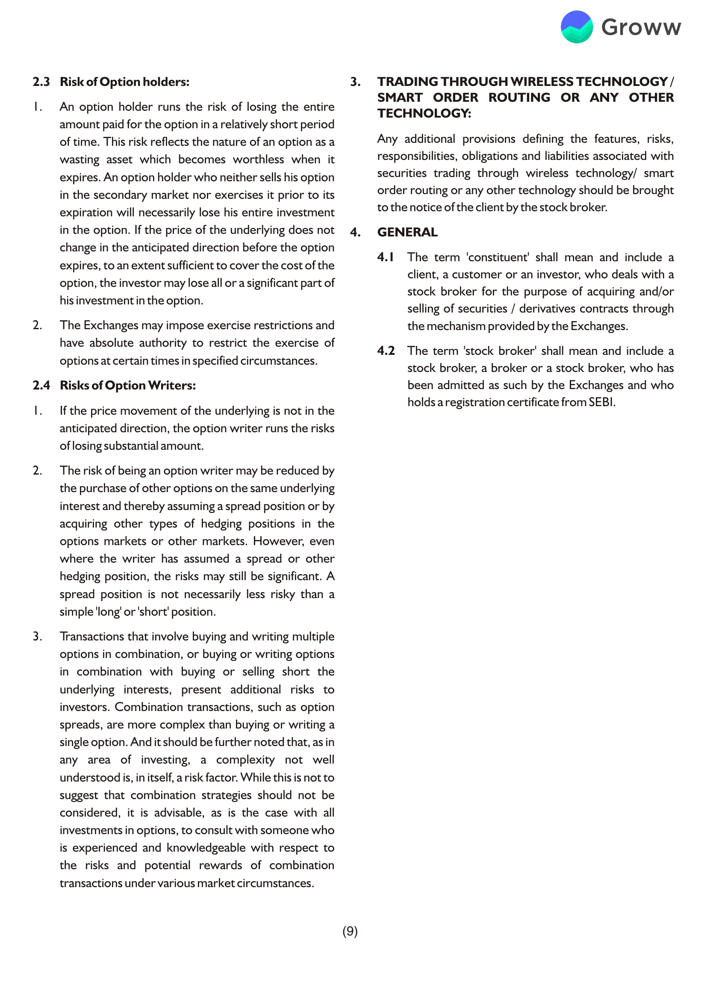


Rank 2:
  Page: 8
  File: groww-client-guidance.pdf
  Distance: 0.0418
  Image Size: (1654, 2339)


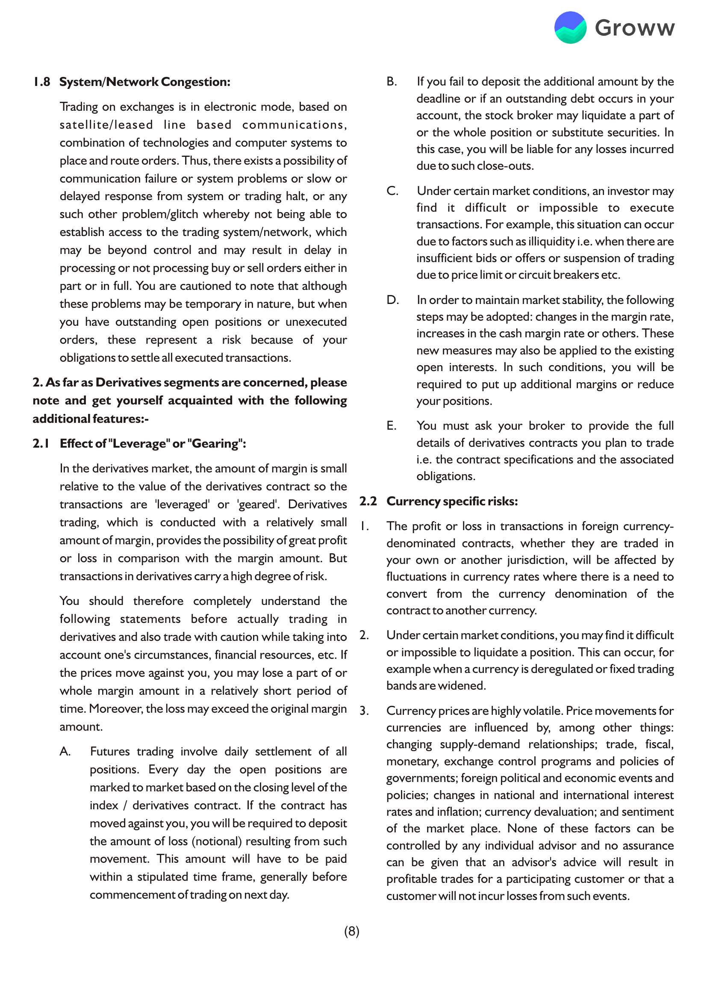


Rank 3:
  Page: 13
  File: groww-client-guidance.pdf
  Distance: 0.0423
  Image Size: (1654, 2339)


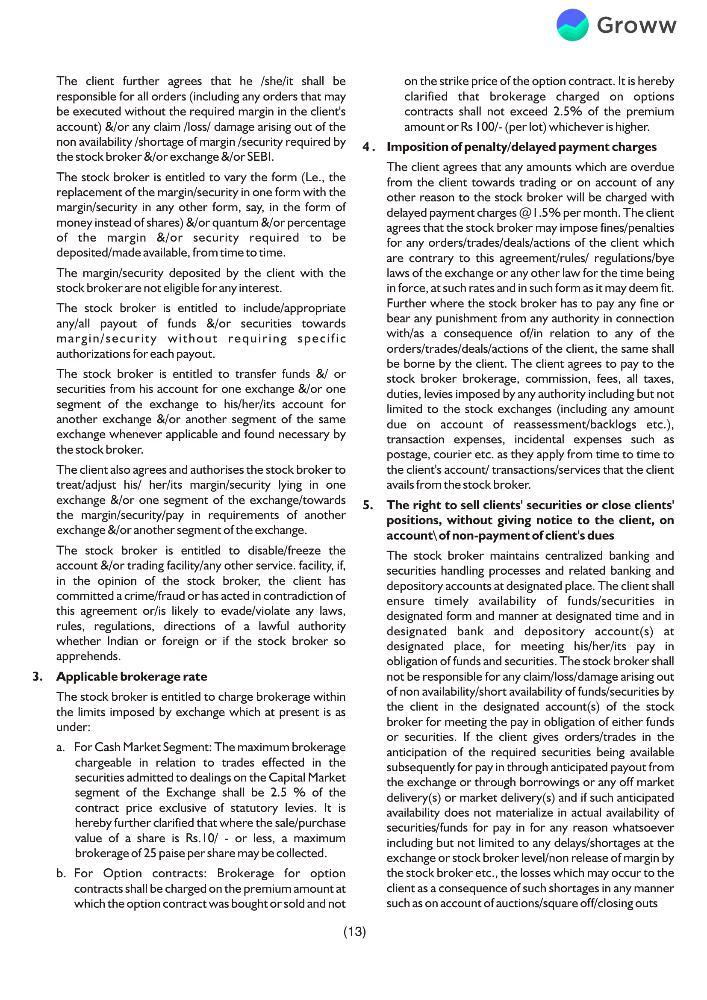

In [ ]:
results = search_images(query, model, processor, faiss_index, images, metadata_list, top_k=3)
display_results(results, query)

In [ ]:
queries_with_correct_pages = [
    ("Electronic Contract Notes", 3),
    ("in case of termination of trading membership", 11),
    ("what is brokerage rage for groww", 13),
     ("Freezing account", 17)
]

Mean Reciprocal Rank (MRR): 0.0833

Detailed Results:

Query: Electronic Contract Notes
Correct Page: 3
Query: Electronic Contract Notes
Top 5 results:
Rank 1:
  Page: 9
  File: groww-client-guidance.pdf
  Distance: 0.0461
  Image Size: (1654, 2339)


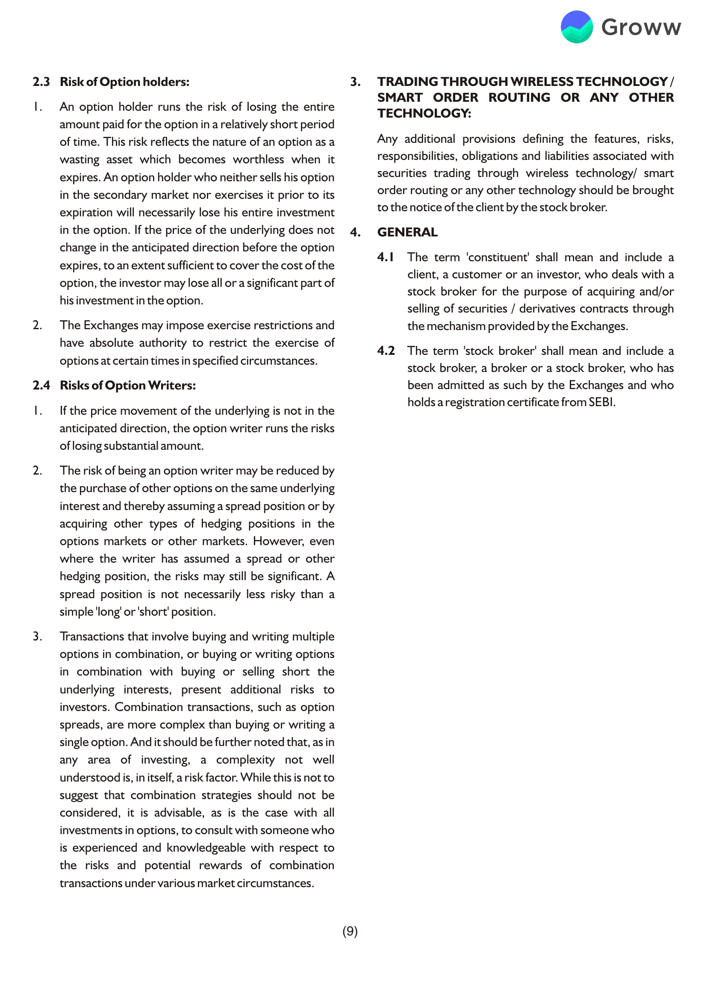


Rank 2:
  Page: 8
  File: groww-client-guidance.pdf
  Distance: 0.0475
  Image Size: (1654, 2339)


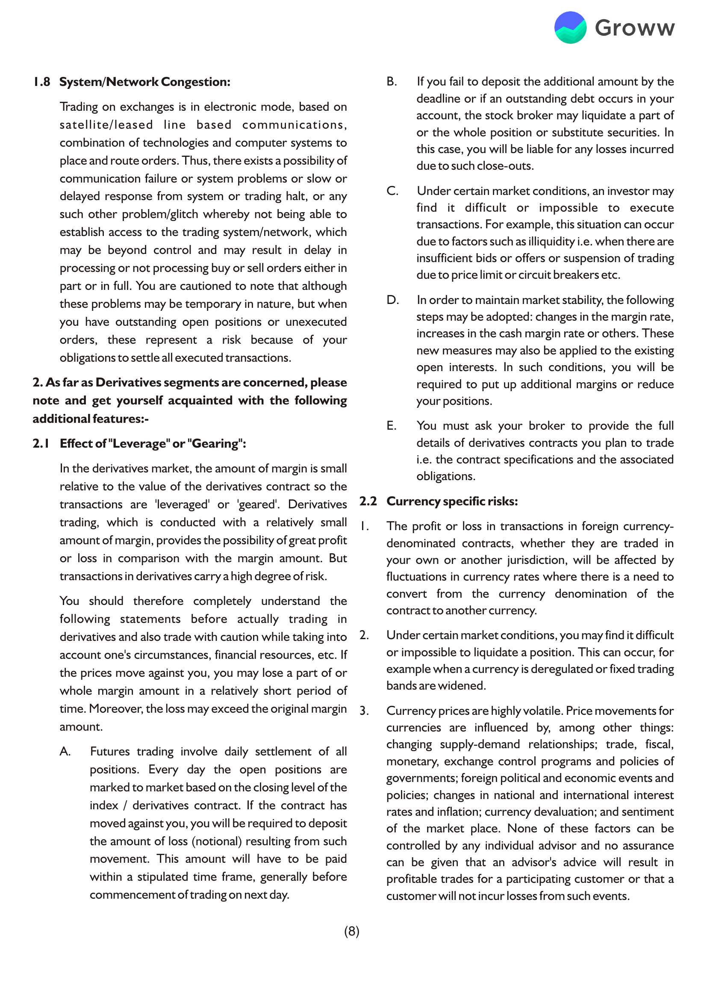


Rank 3:
  Page: 7
  File: groww-client-guidance.pdf
  Distance: 0.0479
  Image Size: (1654, 2339)


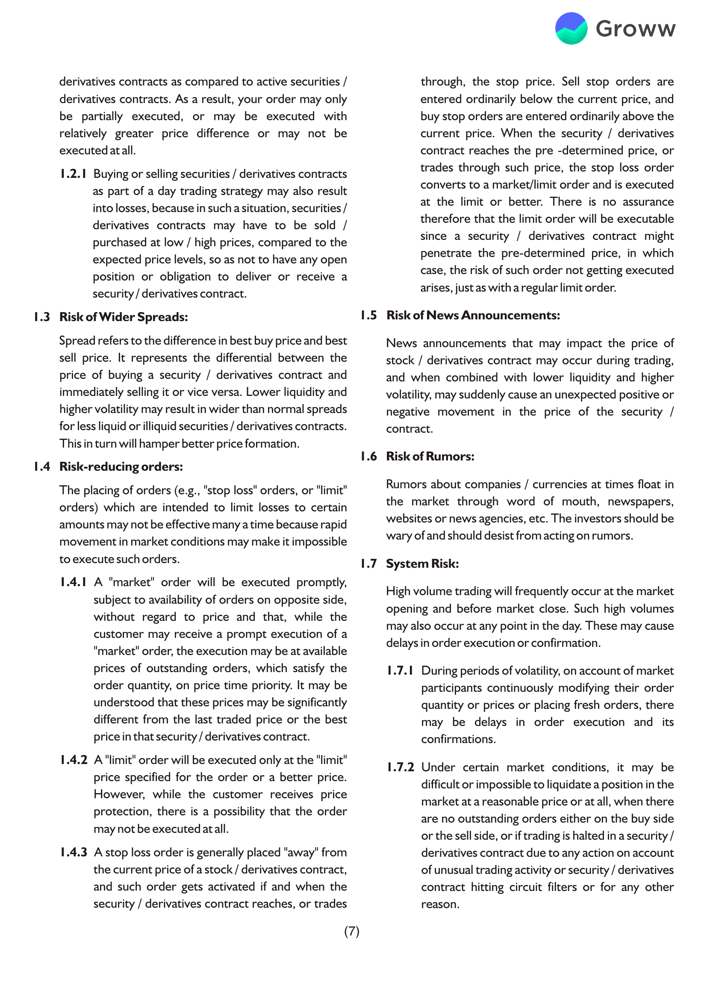


Rank 4:
  Page: 13
  File: groww-client-guidance.pdf
  Distance: 0.0480
  Image Size: (1654, 2339)


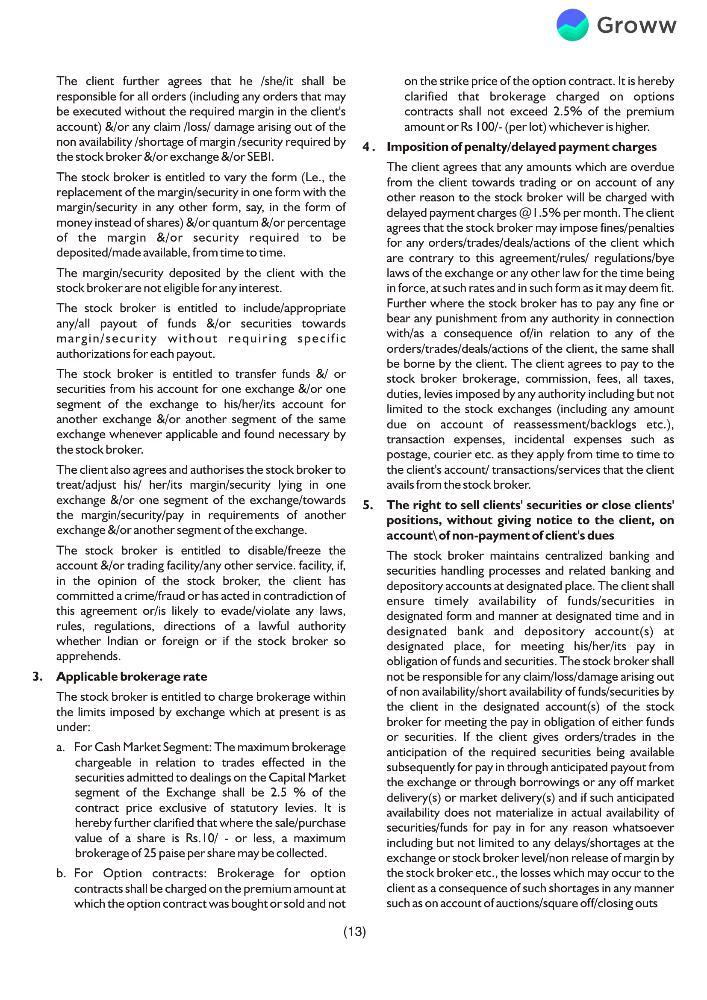


Rank 5:
  Page: 5
  File: groww-client-guidance.pdf
  Distance: 0.0480
  Image Size: (1654, 2339)


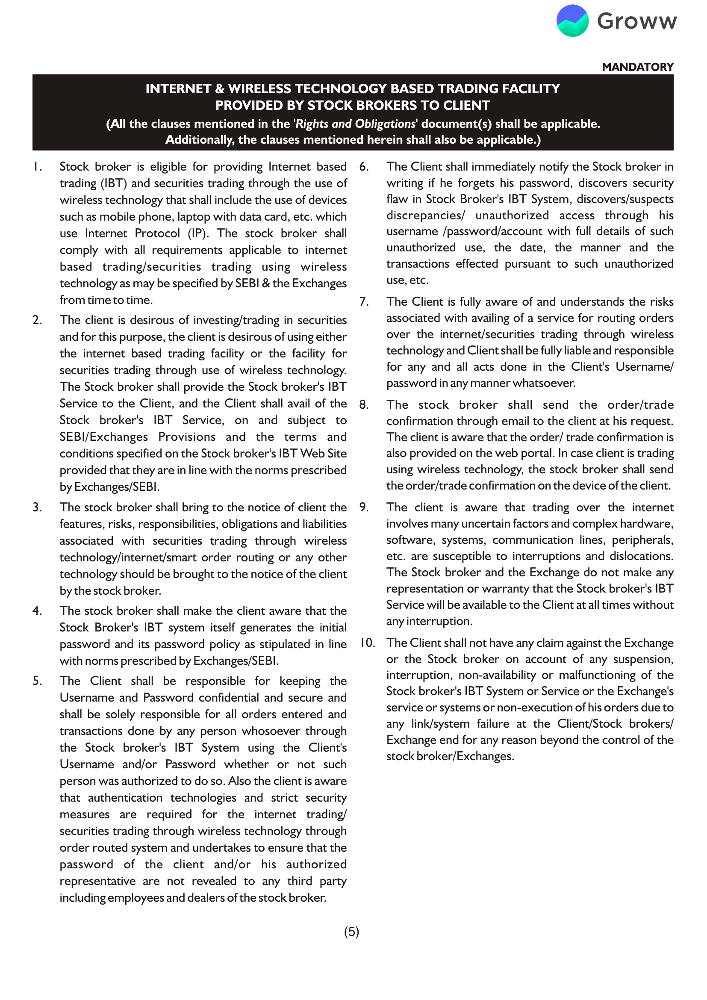



Query: in case of termination of trading membership
Correct Page: 11
Query: in case of termination of trading membership
Top 5 results:
Rank 1:
  Page: 13
  File: groww-client-guidance.pdf
  Distance: 0.0347
  Image Size: (1654, 2339)


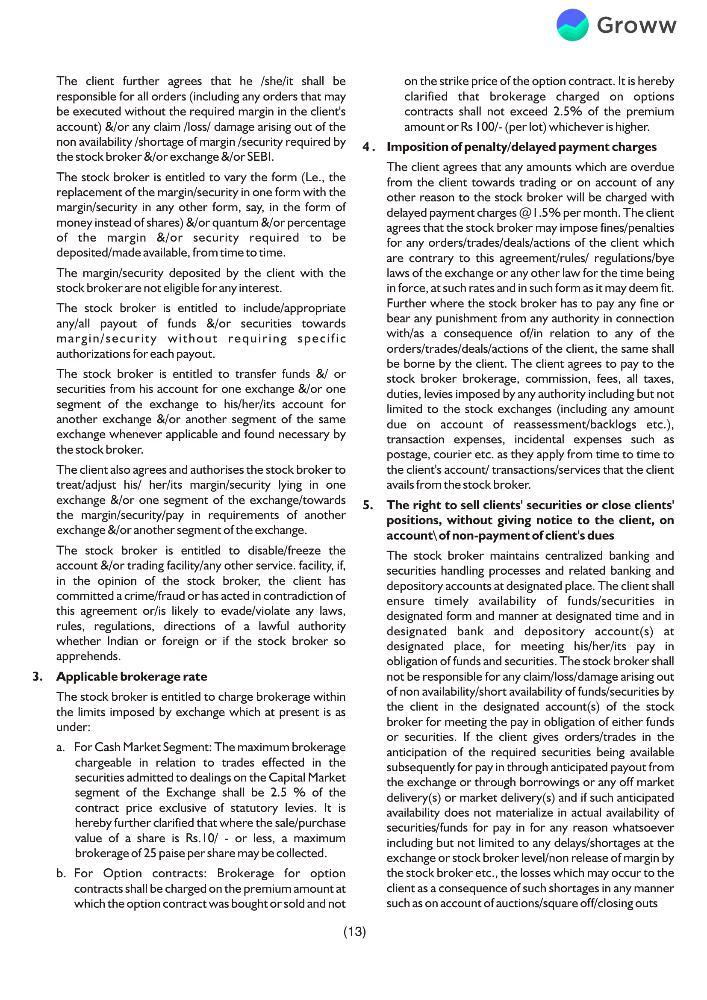


Rank 2:
  Page: 12
  File: groww-client-guidance.pdf
  Distance: 0.0356
  Image Size: (1654, 2339)


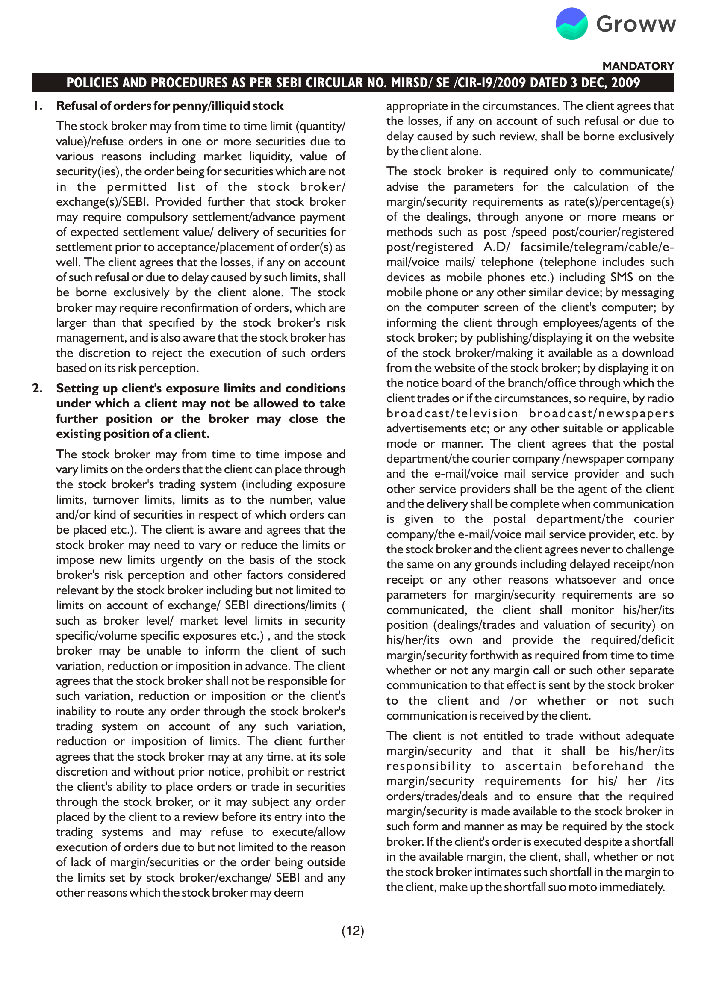


Rank 3:
  Page: 9
  File: groww-client-guidance.pdf
  Distance: 0.0358
  Image Size: (1654, 2339)


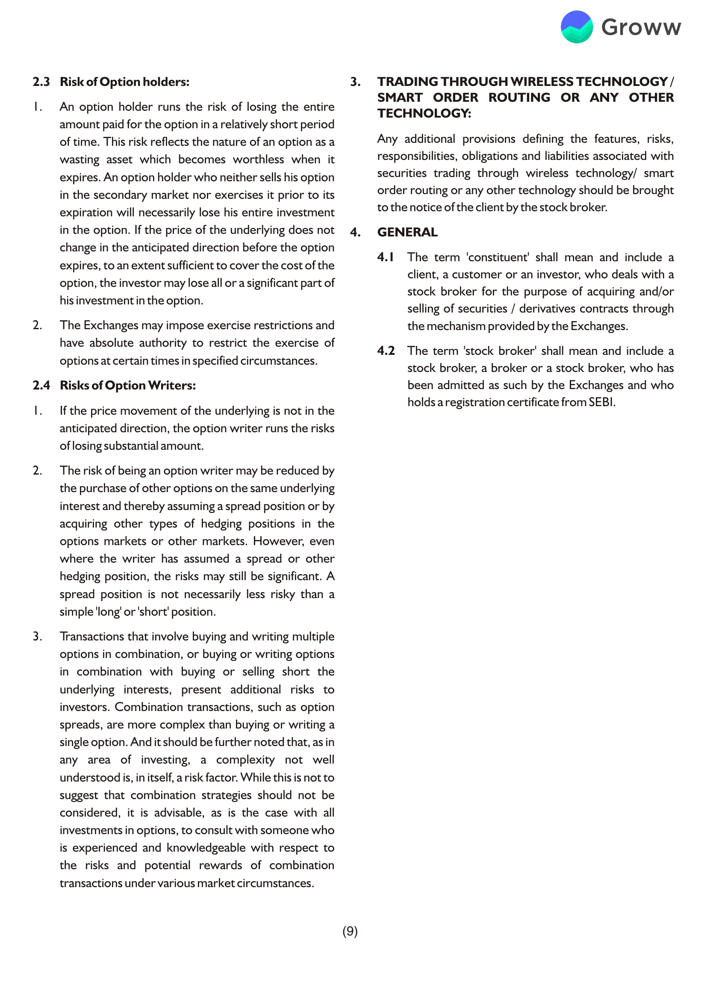


Rank 4:
  Page: 14
  File: groww-client-guidance.pdf
  Distance: 0.0358
  Image Size: (1654, 2339)


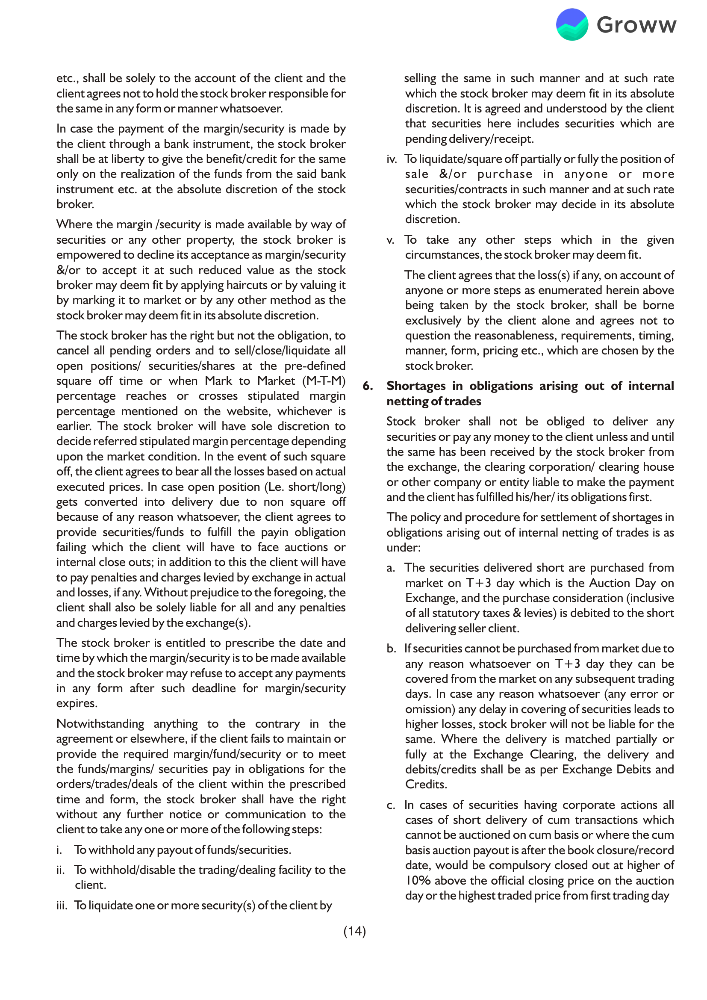


Rank 5:
  Page: 8
  File: groww-client-guidance.pdf
  Distance: 0.0359
  Image Size: (1654, 2339)


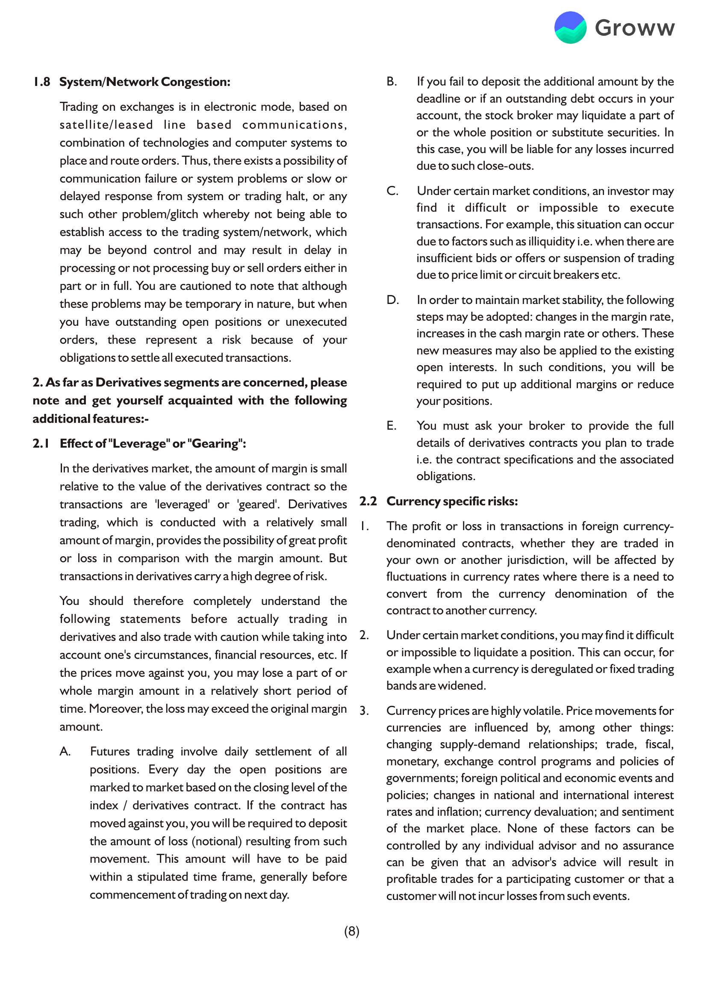



Query: what is brokerage rage for groww
Correct Page: 13
Query: what is brokerage rage for groww
Top 5 results:
Rank 1:
  Page: 9
  File: groww-client-guidance.pdf
  Distance: 0.0416
  Image Size: (1654, 2339)


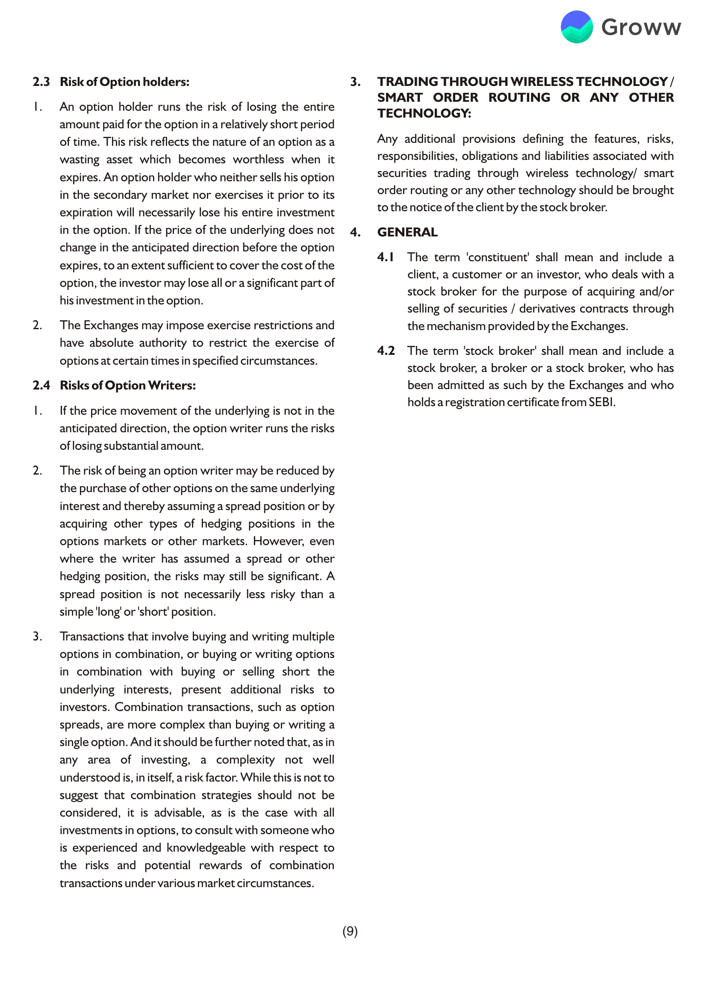


Rank 2:
  Page: 8
  File: groww-client-guidance.pdf
  Distance: 0.0418
  Image Size: (1654, 2339)


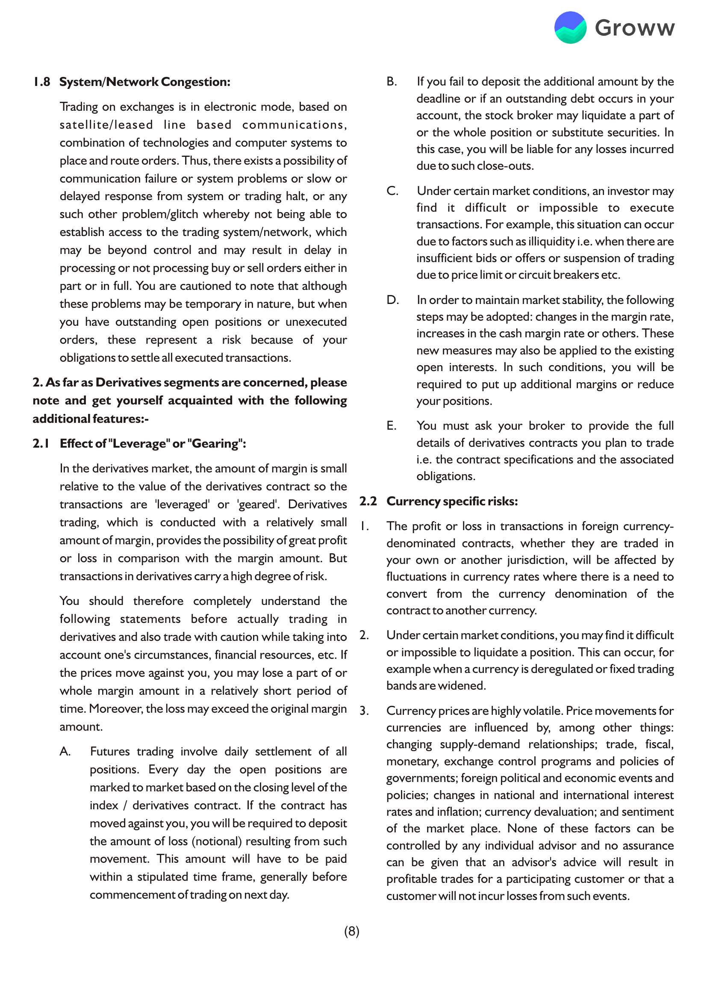


Rank 3:
  Page: 13
  File: groww-client-guidance.pdf
  Distance: 0.0423
  Image Size: (1654, 2339)


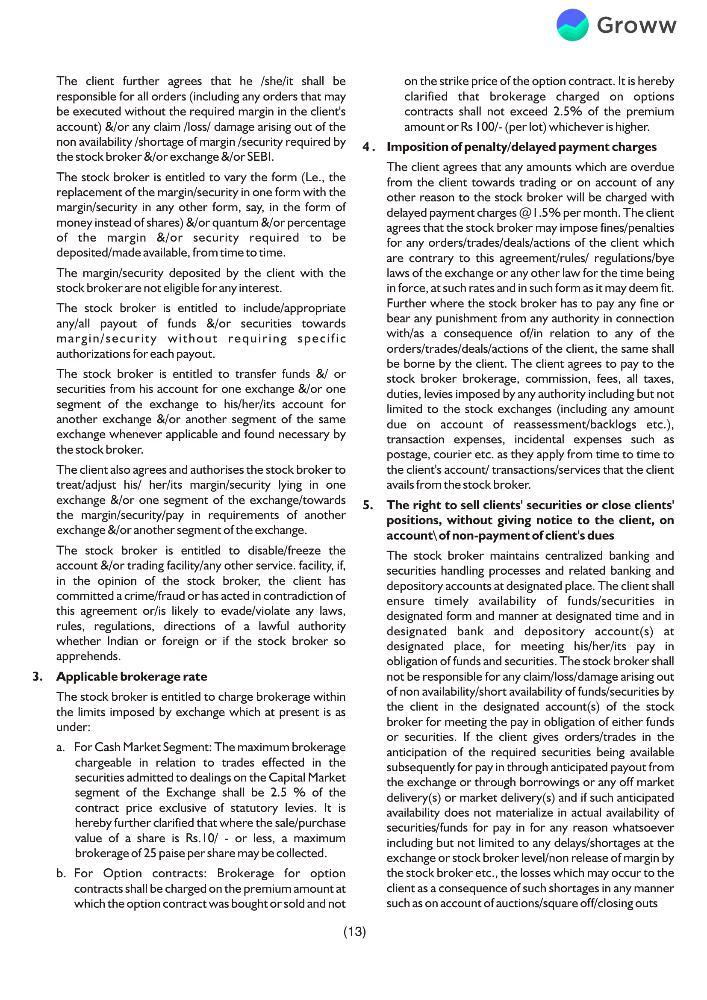


Rank 4:
  Page: 14
  File: groww-client-guidance.pdf
  Distance: 0.0423
  Image Size: (1654, 2339)


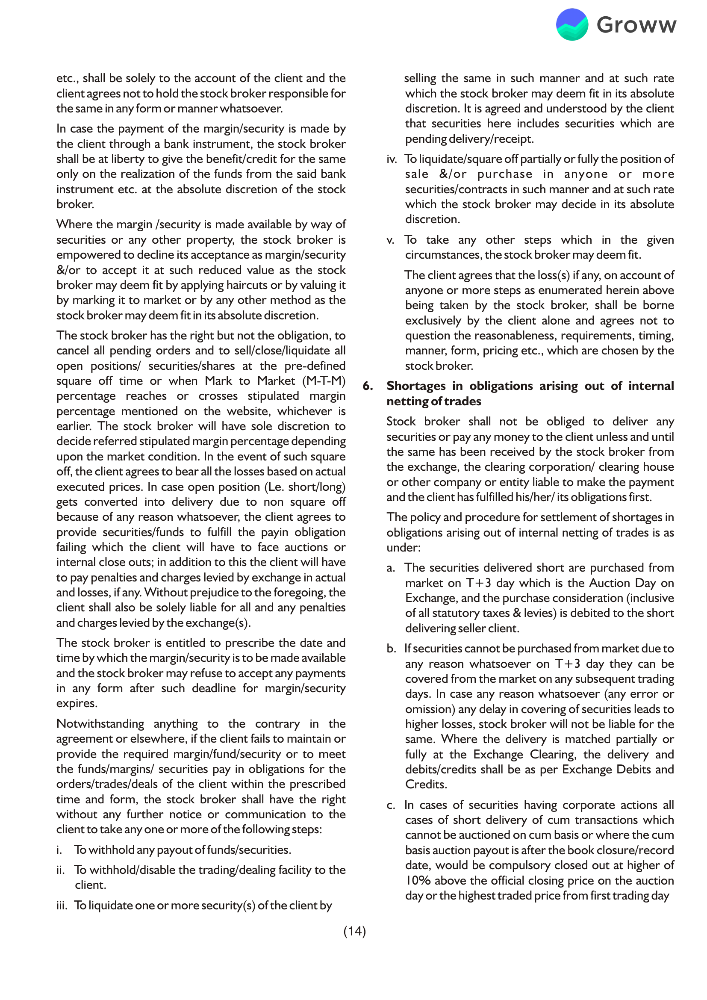


Rank 5:
  Page: 7
  File: groww-client-guidance.pdf
  Distance: 0.0424
  Image Size: (1654, 2339)


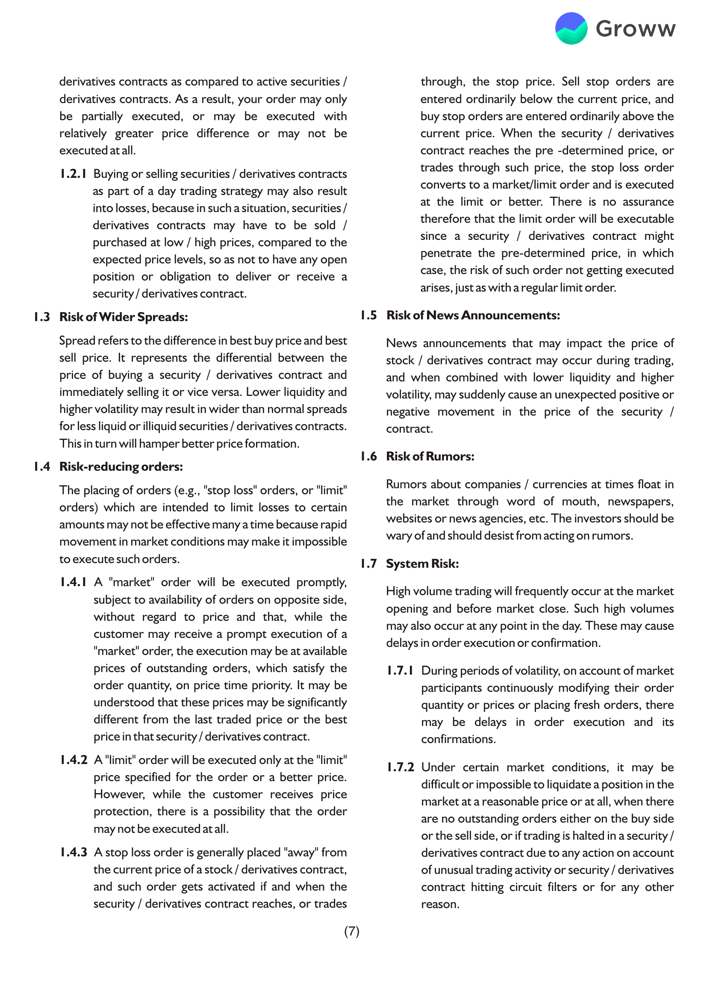



Query: Freezing account
Correct Page: 17
Query: Freezing account
Top 5 results:
Rank 1:
  Page: 9
  File: groww-client-guidance.pdf
  Distance: 0.0447
  Image Size: (1654, 2339)


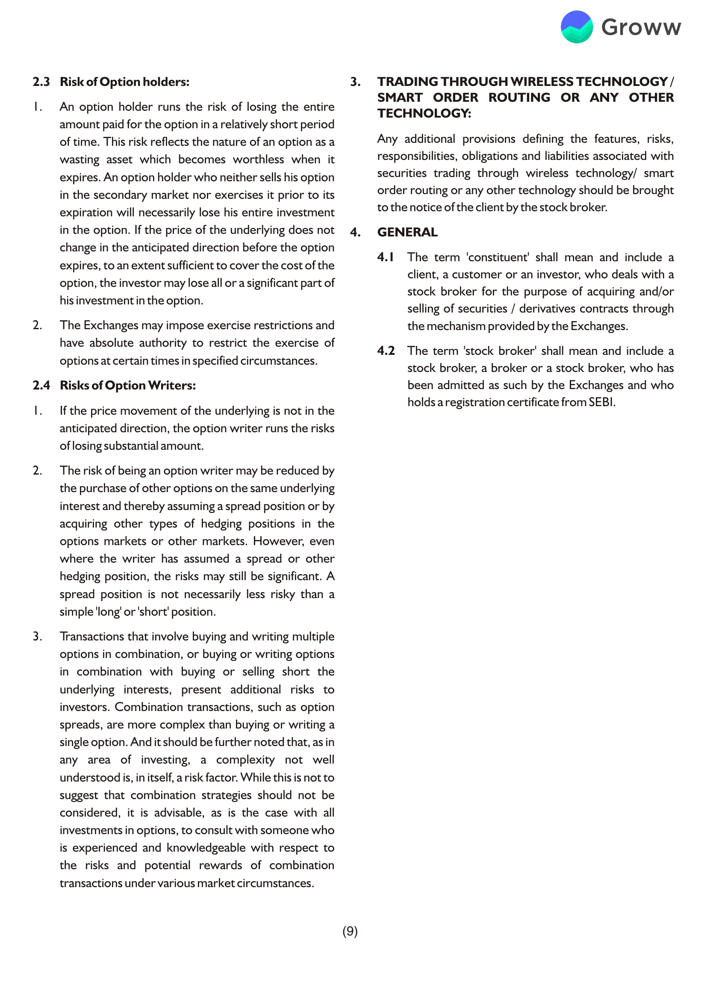


Rank 2:
  Page: 8
  File: groww-client-guidance.pdf
  Distance: 0.0450
  Image Size: (1654, 2339)


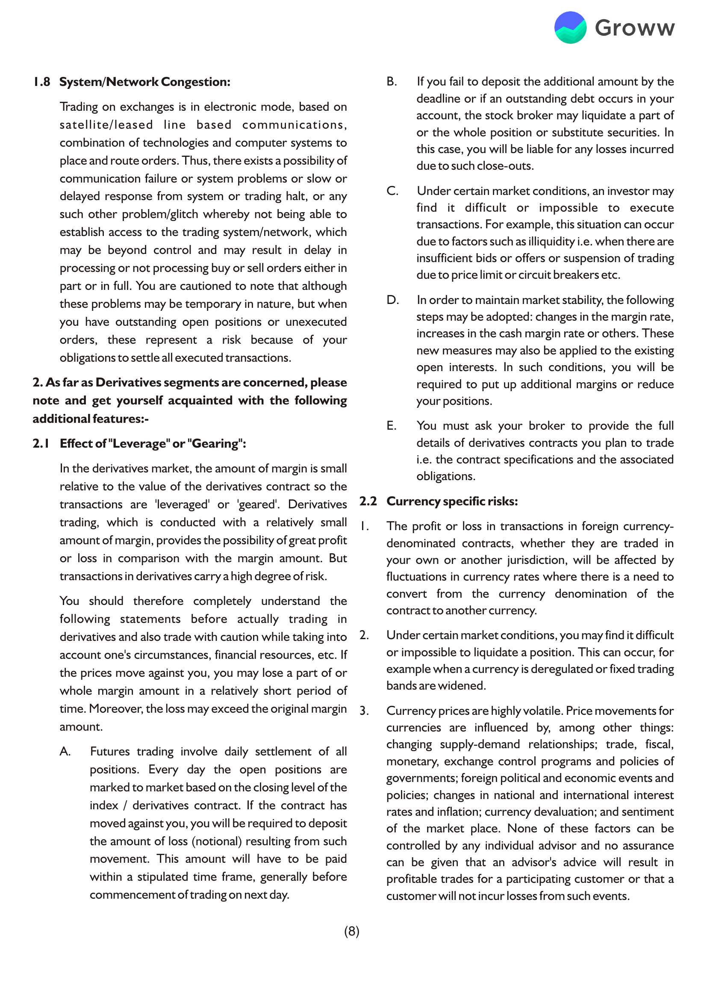


Rank 3:
  Page: 13
  File: groww-client-guidance.pdf
  Distance: 0.0454
  Image Size: (1654, 2339)


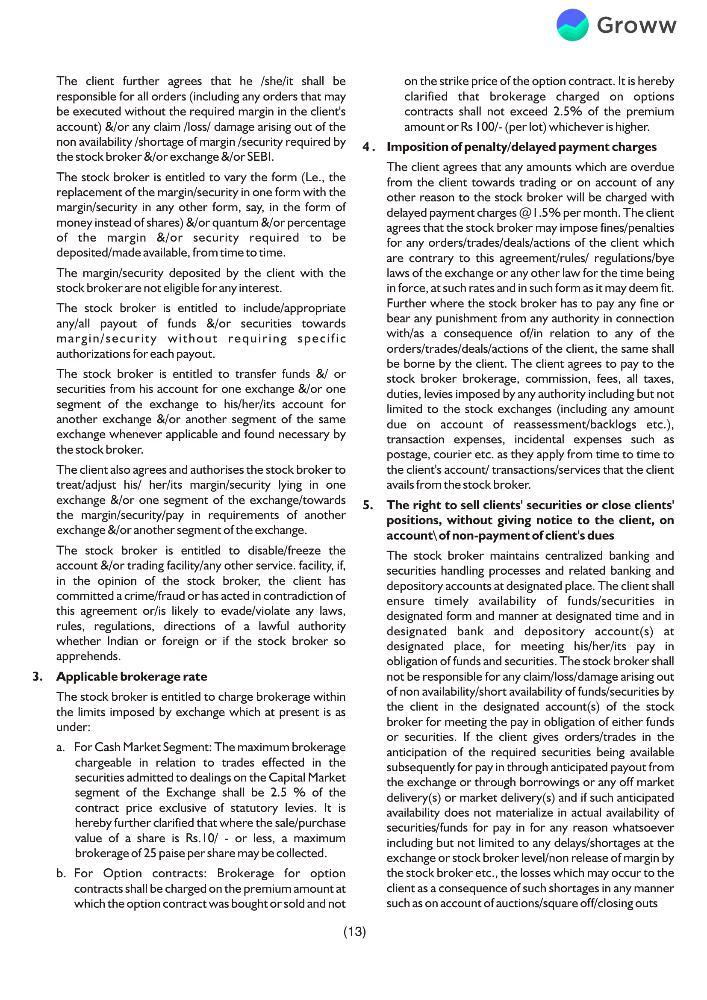


Rank 4:
  Page: 7
  File: groww-client-guidance.pdf
  Distance: 0.0456
  Image Size: (1654, 2339)


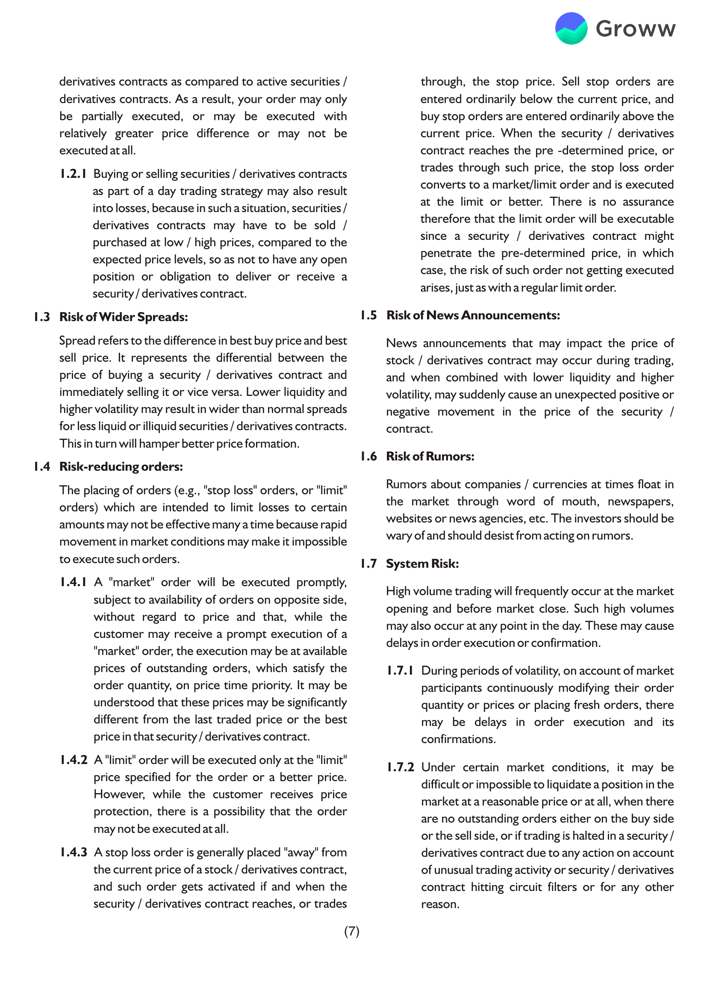


Rank 5:
  Page: 14
  File: groww-client-guidance.pdf
  Distance: 0.0457
  Image Size: (1654, 2339)


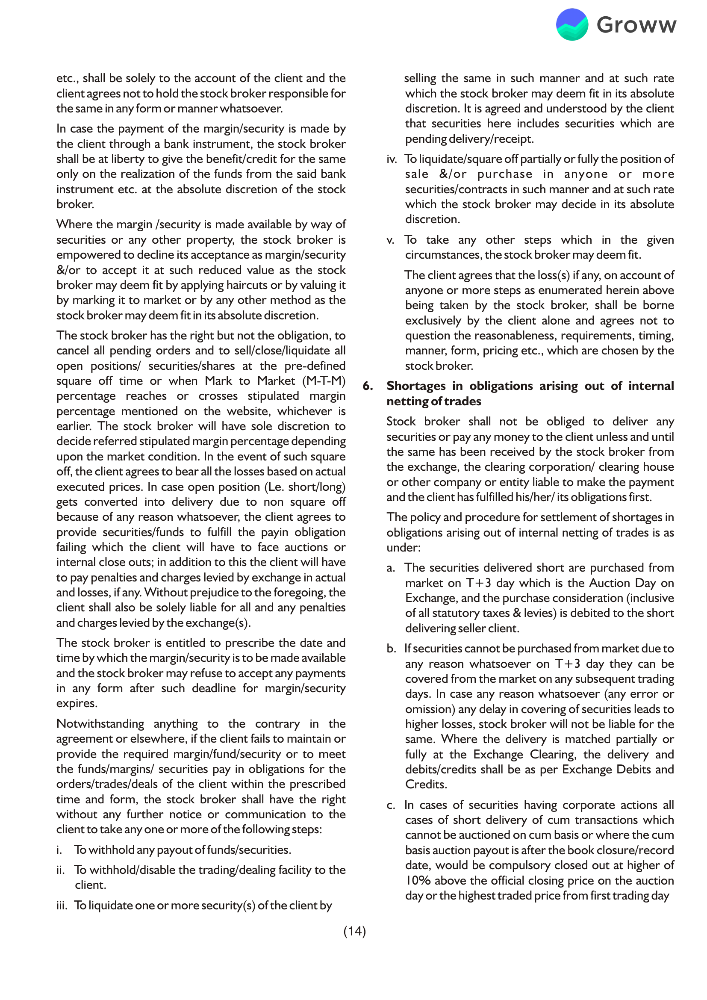

In [ ]:
evaluate_and_display_results(queries_with_correct_pages, model, processor, faiss_index, images, metadata_list, top_k=5)